In [4]:
import os
import numpy as np
import pandas as pd
from tqdm.notebook import tqdm
import jovian
import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline
matplotlib.rcParams['figure.facecolor'] = '#ffffff'
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torchvision
import torchvision.transforms as T
from torchvision.utils import make_grid
from torchvision.utils import save_image
from torch.utils.data import DataLoader
from torchvision.datasets import ImageFolder

<IPython.core.display.Javascript object>

C:\Users\abyad\.conda\envs\Cudas\lib\site-packages\tqdm\auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [5]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(device)

cuda


In [6]:
data_dir = './data/cifar10/train'

classes = os.listdir(data_dir)
print(classes)

['airplane', 'automobile', 'bird', 'cat', 'deer', 'dog', 'frog', 'horse', 'ship', 'truck']


In [7]:
image_size = 64
batch_size = 100
stats = (0.5, 0.5, 0.5), (0.5, 0.5, 0.5)
train_data_dir = './data/cifar10/train/'
test_data_dir = './data/cifar10/test/'

train_ds = ImageFolder(train_data_dir, transform=T.Compose([
    T.Resize(image_size),
    T.CenterCrop(image_size),
    T.ToTensor(),
    T.Normalize(*stats)]))

test_ds = ImageFolder(test_data_dir, transform=T.Compose([
    T.Resize(image_size),
    T.CenterCrop(image_size),
    T.ToTensor(),
    T.Normalize(*stats)]))

dataset = torch.utils.data.ConcatDataset([train_ds, test_ds])
trainloader = torch.utils.data.DataLoader(dataset, batch_size = batch_size, 
                                         num_workers = 4, shuffle = True, pin_memory=True)

In [8]:
classes = ('airplane', 'automobile', 'bird', 'cat', 'deer', 'dog', 'frog', 'horse', 'ship', 'truck', 'fake')

In [9]:
def showImage(images,epoch=-99, idx = -99):
    
    
    images = images.cpu().numpy()
    images = images/2 + 0.5
    fig, ax = plt.subplots(figsize=(16, 16))
    ax.set_xticks([]); ax.set_yticks([])
    ax.imshow(np.transpose(images,axes = (1,2,0)))
    
    #plt.imshow(np.transpose(images,axes = (1,2,0)))
    #plt.axis('off')

    if epoch!=-99:
        plt.savefig("e" + str(epoch) + "i" + str(idx) + ".png")

torch.Size([100, 3, 64, 64])


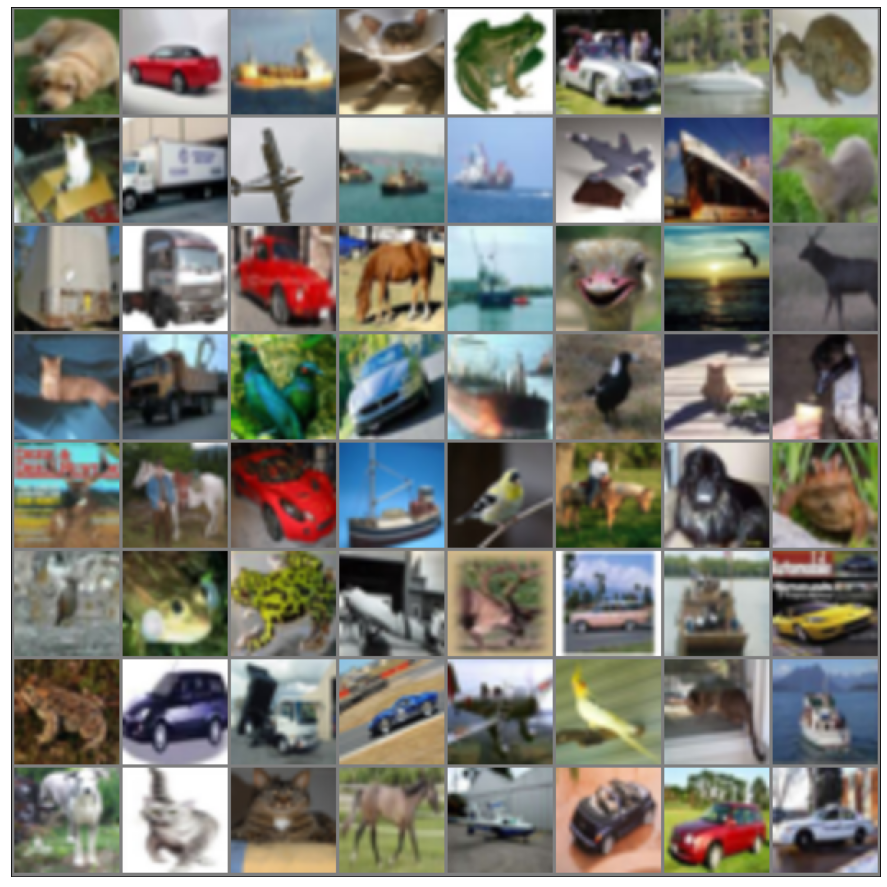

In [10]:
dataiter = iter(trainloader)
images,labels = dataiter.next()
print(images.size())
showImage(make_grid(images[0:64]))

In [11]:
class Generator(nn.Module):
    
    def __init__(self):
        super(Generator,self).__init__()
        
        #input 100*1*1
        self.layer1 = nn.Sequential(nn.ConvTranspose2d(100,512,4,1,0,bias = False),
                                   nn.ReLU(True))

        #input 512*4*4
        self.layer2 = nn.Sequential(nn.ConvTranspose2d(512,256,4,2,1,bias = False),
                                   nn.BatchNorm2d(256),
                                   nn.ReLU(True))
        #input 256*8*8
        self.layer3 = nn.Sequential(nn.ConvTranspose2d(256,128,4,2,1,bias = False),
                                   nn.BatchNorm2d(128),
                                   nn.ReLU(True))
        #input 128*16*16
        self.layer4 = nn.Sequential(nn.ConvTranspose2d(128,64,4,2,1,bias = False),
                                   nn.BatchNorm2d(64),
                                   nn.ReLU(True))
        #input 64*32*32
        self.layer5 = nn.Sequential(nn.ConvTranspose2d(64,3,4,2,1,bias = False),
                                   nn.Tanh())
        #output 3*64*64
      
        self.embedding = nn.Embedding(10,100)
        
        
    def forward(self,noise,label):
        
        label_embedding = self.embedding(label)
        x = torch.mul(noise,label_embedding)
        x = x.view(-1,100,1,1)
        
        x = self.layer1(x)
        x = self.layer2(x)
        x = self.layer3(x)
        x = self.layer4(x)
        x = self.layer5(x)
        return x

In [12]:
class Discriminator(nn.Module):
    
    def __init__(self):
        super(Discriminator,self).__init__()        
        
        #input 3*64*64
        self.layer1 = nn.Sequential(nn.Conv2d(3,64,4,2,1,bias = False),
                                    nn.BatchNorm2d(64),
                                   nn.LeakyReLU(0.2,True),
                                   nn.Dropout2d(0.5))
        
        #input 64*32*32
        self.layer2 = nn.Sequential(nn.Conv2d(64,128,4,2,1,bias = False),
                                    nn.BatchNorm2d(128),
                                   nn.LeakyReLU(0.2,True),
                                   nn.Dropout2d(0.5))
        #input 128*16*16
        self.layer3 = nn.Sequential(nn.Conv2d(128,256,4,2,1,bias = False),
                                    nn.BatchNorm2d(256),
                                   nn.LeakyReLU(0.2,True),
                                   nn.Dropout2d(0.5))
        #input 256*8*8
        self.layer4 = nn.Sequential(nn.Conv2d(256,512,4,2,1,bias = False),
                                    nn.BatchNorm2d(512),
                                   nn.LeakyReLU(0.2,True))
        #input 512*4*4
        self.validity_layer = nn.Sequential(nn.Conv2d(512,1,4,1,0,bias = False),
                                   nn.Sigmoid())
        
        self.label_layer = nn.Sequential(nn.Conv2d(512,11,4,1,0,bias = False),
                                   nn.LogSoftmax(dim = 1))
        
    def forward(self,x):
        
        x = self.layer1(x)
        x = self.layer2(x)
        x = self.layer3(x)
        x = self.layer4(x)
        validity = self.validity_layer(x)
        plabel = self.label_layer(x)
        
        validity = validity.view(-1)
        plabel = plabel.view(-1,11)
        
        return validity,plabel

In [13]:
# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        m.weight.data.normal_(0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        m.weight.data.normal_(1.0, 0.02)
        m.bias.data.fill_(0)

gen = Generator().to(device)
gen.apply(weights_init)

disc = Discriminator().to(device)
disc.apply(weights_init)

paramsG = list(gen.parameters())
paramsD = list(disc.parameters())     
        
optimG = optim.Adam(gen.parameters(), lr = 0.0002, betas = (0.5,0.999))
optimD = optim.Adam(disc.parameters(), lr = 0.0002, betas = (0.5,0.999))

validity_loss = nn.BCELoss()

real_labels = 0.7 + 0.5 * torch.rand(10, device = device)
fake_labels = 0.3 * torch.rand(10, device = device)

In [14]:
def fit(epochs):
    torch.cuda.empty_cache()
    
    # Losses & scores
    losses_g = []
    losses_d = []
    real_scores = []
    fake_scores = []
    
    for epoch in range(1,epochs+1):
        
        #idx = 0
    
        #for images,labels in tqdm(trainloader):
        for idx, (images,labels) in enumerate(trainloader,0):

            batch_size = images.size(0)
            labels= labels.to(device)
            images = images.to(device)

            real_label = real_labels[idx % 10]
            fake_label = fake_labels[idx % 10]

            fake_class_labels = 10*torch.ones((batch_size,),dtype = torch.long,device = device)

            if idx % 25 == 0:
                real_label, fake_label = fake_label, real_label

            # ---------------------
            #         discriminator
            # ---------------------

            optimD.zero_grad()       

            # real
            validity_label = torch.full((batch_size,),real_label , device = device)

            pvalidity, plabels = disc(images)       

            errD_real_val = validity_loss(pvalidity, validity_label)            
            errD_real_label = F.nll_loss(plabels,labels)

            errD_real = errD_real_val + errD_real_label
            errD_real.backward()

            D_x = pvalidity.mean().item()        

            #fake 
            noise = torch.randn(batch_size,100,device = device)  
            sample_labels = torch.randint(0,10,(batch_size,),device = device, dtype = torch.long)

            fakes = gen(noise,sample_labels)

            validity_label.fill_(fake_label)

            pvalidity, plabels = disc(fakes.detach())       

            errD_fake_val = validity_loss(pvalidity, validity_label)
            errD_fake_label = F.nll_loss(plabels, fake_class_labels)

            errD_fake = errD_fake_val + errD_fake_label
            errD_fake.backward()

            D_G_z1 = pvalidity.mean().item()

            #finally update the params!
            errD = errD_real + errD_fake

            optimD.step()


            # ------------------------
            #      generator
            # ------------------------


            optimG.zero_grad()

            noise = torch.randn(batch_size,100,device = device)  
            sample_labels = torch.randint(0,10,(batch_size,),device = device, dtype = torch.long)

            validity_label.fill_(1)

            fakes = gen(noise,sample_labels)
            pvalidity,plabels = disc(fakes)

            errG_val = validity_loss(pvalidity, validity_label)        
            errG_label = F.nll_loss(plabels, sample_labels)

            errG = errG_val + errG_label
            errG.backward()

            D_G_z2 = pvalidity.mean().item()

            optimG.step()

            if idx % 100 == 0:
                noise = torch.randn(10,100,device = device)  
                labels = torch.arange(0,10,dtype = torch.long,device = device)

                gen_images = gen(noise,labels).detach()

                showImage(make_grid(gen_images),epoch,idx)
                
            #idx += 1
        
        # Record losses & scores
        losses_g.append(errG)
        losses_d.append(errD)
        real_scores.append(errD_real_label)
        fake_scores.append(errD_fake_label)
        
        # Log losses & scores (last batch)
        print("Epoch [{}/{}], loss_g: {:.4f}, loss_d: {:.4f}, real_score: {:.4f}, fake_score: {:.4f}".format(
            epoch, epochs+1, errG, errD, errD_real_label, errD_fake_label))
        
    return losses_g, losses_d, real_scores, fake_scores

Epoch [1/26], loss_g: 4.6082, loss_d: 4.0972, real_score: 2.2391, fake_score: 0.4947
Epoch [2/26], loss_g: 4.2748, loss_d: 4.9933, real_score: 2.7311, fake_score: 0.7125
Epoch [3/26], loss_g: 2.5840, loss_d: 4.1219, real_score: 2.4186, fake_score: 0.3827


C:\Users\abyad\AppData\Local\Temp\ipykernel_3688\3356586621.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(figsize=(16, 16))


Epoch [4/26], loss_g: 2.4266, loss_d: 4.4277, real_score: 2.4106, fake_score: 0.6110
Epoch [5/26], loss_g: 2.4033, loss_d: 4.4001, real_score: 2.1890, fake_score: 0.7610
Epoch [6/26], loss_g: 2.0143, loss_d: 4.5221, real_score: 2.2228, fake_score: 0.8444
Epoch [7/26], loss_g: 2.5254, loss_d: 4.3594, real_score: 2.4918, fake_score: 0.4888
Epoch [8/26], loss_g: 2.1948, loss_d: 4.1153, real_score: 2.0572, fake_score: 0.6775
Epoch [9/26], loss_g: 2.2993, loss_d: 4.2317, real_score: 2.0642, fake_score: 0.7301
Epoch [10/26], loss_g: 2.6794, loss_d: 3.9168, real_score: 1.8477, fake_score: 0.6617
Epoch [11/26], loss_g: 2.5589, loss_d: 3.7256, real_score: 1.9651, fake_score: 0.4253
Epoch [12/26], loss_g: 2.6821, loss_d: 4.5363, real_score: 2.3554, fake_score: 0.7206
Epoch [13/26], loss_g: 2.7843, loss_d: 4.6322, real_score: 2.3283, fake_score: 0.7970
Epoch [14/26], loss_g: 2.9570, loss_d: 4.3007, real_score: 2.0855, fake_score: 0.7224
Epoch [15/26], loss_g: 2.1632, loss_d: 4.0239, real_score: 1

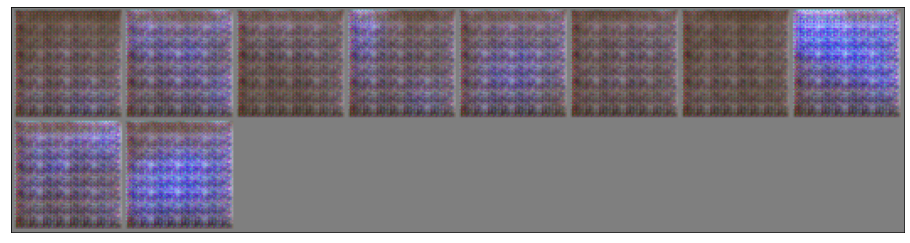

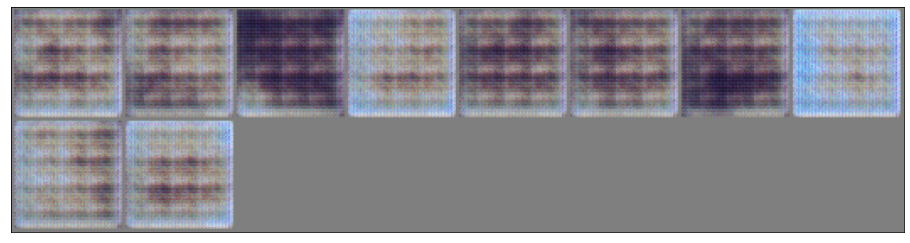

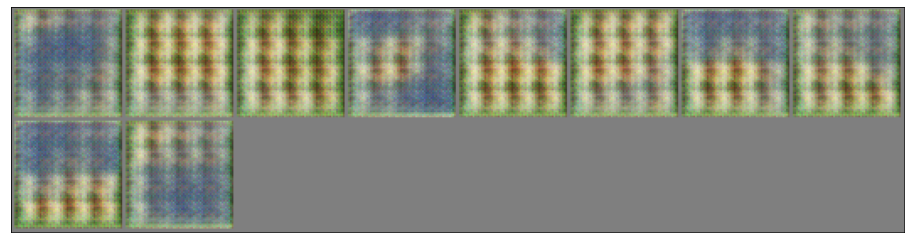

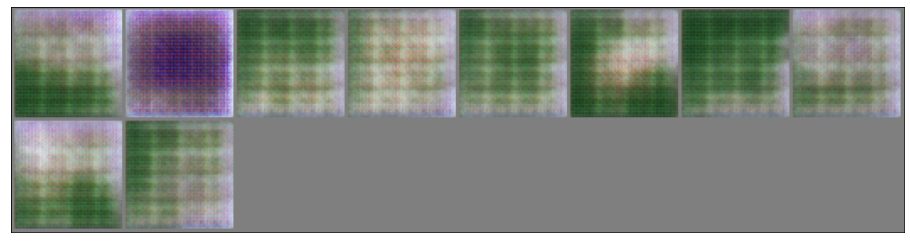

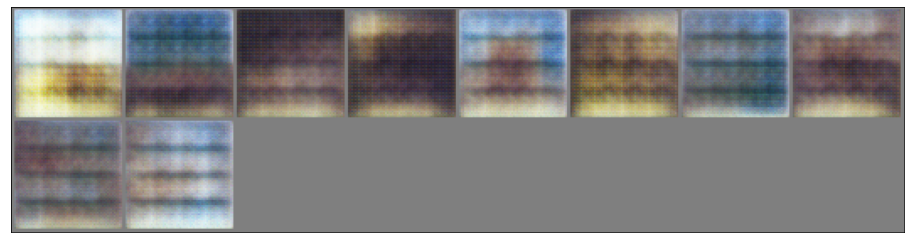

...

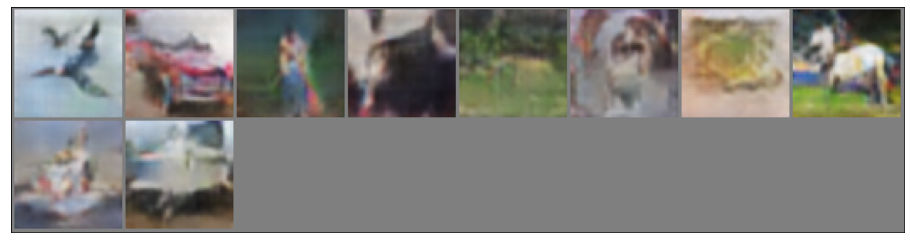

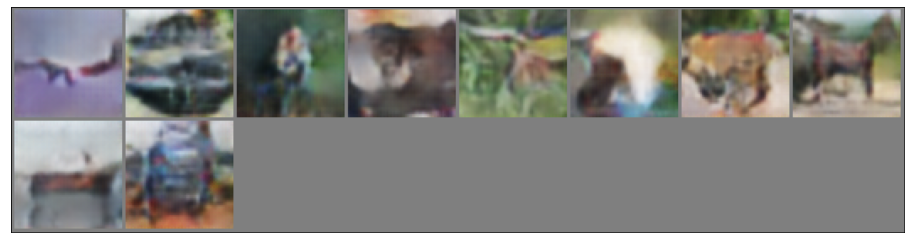

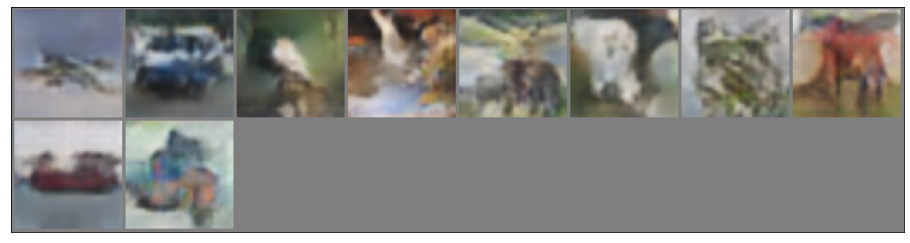

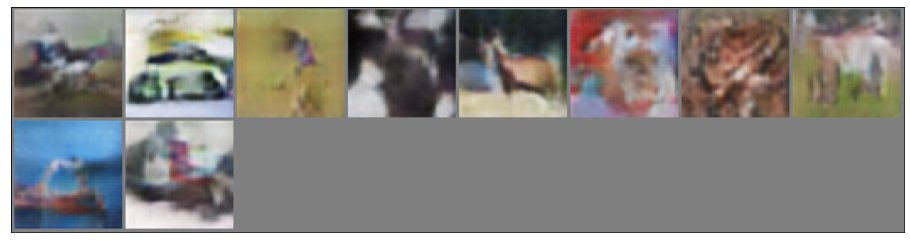

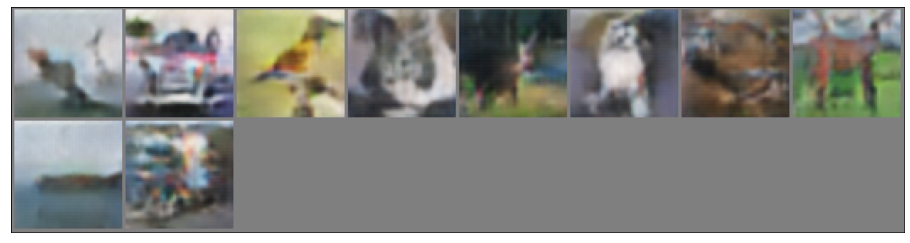

In [20]:
history = []
epochs = 25

history += fit(epochs)

losses_g, losses_d, real_scores, fake_scores = history

In [21]:
# Save the model checkpoints 
torch.save(gen.state_dict(), 'G2_local.pth')
torch.save(disc.state_dict(), 'D2_local.pth')

In [22]:
losses_g_cpu = [x.detach().cpu().item() for x in losses_g]
losses_d_cpu = [x.detach().cpu().item() for x in losses_d]
real_scores_cpu = [x.detach().cpu().item() for x in real_scores]
fake_scores_cpu = [x.detach().cpu().item() for x in fake_scores]

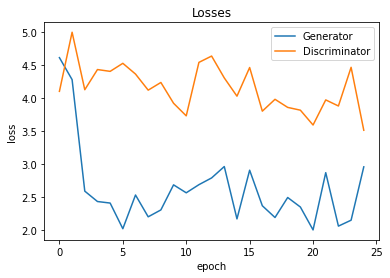

In [23]:
plt.plot(losses_g_cpu, '-')
plt.plot(losses_d_cpu, '-')
plt.xlabel('epoch')
plt.ylabel('loss')
plt.legend(['Generator','Discriminator'])
plt.title('Losses');

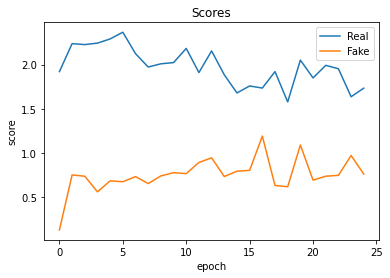

In [59]:
plt.plot(real_scores_cpu, '-')
plt.plot(fake_scores_cpu, '-')
plt.xlabel('epoch')
plt.ylabel('score')
plt.legend(['Real', 'Fake'])
plt.title('Scores');